# Predicting Parkinson Disease

In [1]:
#Data Preprocessing Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import StandardScaler
import squarify
from sklearn import svm

# Machine learning models libraries
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import ElasticNet
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
import xgboost as xgb
from sklearn.ensemble import BaggingClassifier
from catboost import CatBoostClassifier
from sklearn.ensemble import StackingClassifier
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import VotingClassifier

# Evalution measures
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report, roc_curve, roc_auc_score, auc

# Loading the DataSet

In [2]:
data = pd.read_csv("D:\\Placement\\Parkinson Disease Project\\parkinsons.csv")
data

,name,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
0,phon_R01_S01_1,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,...,0.06545,0.02211,21.033,1,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,phon_R01_S01_2,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,...,0.09403,0.01929,19.085,1,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,phon_R01_S01_3,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,...,0.08270,0.01309,20.651,1,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,phon_R01_S01_4,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,...,0.08771,0.01353,20.644,1,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,phon_R01_S01_5,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,...,0.10470,0.01767,19.649,1,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,phon_R01_S50_2,174.188,230.978,94.261,0.00459,0.00003,0.00263,0.00259,0.00790,0.04087,...,0.07008,0.02764,19.517,0,0.448439,0.657899,-6.538586,0.121952,2.657476,0.133050
191,phon_R01_S50_3,209.516,253.017,89.488,0.00564,0.00003,0.00331,0.00292,0.00994,0.02751,...,0.04812,0.01810,19.147,0,0.431674,0.683244,-6.195325,0.129303,2.784312,0.168895
192,phon_R01_S50_4,174.688,240.005,74.287,0.01360,0.00008,0.00624,0.00564,0.01873,0.02308,...,0.03804,0.10715,17.883,0,0.407567,0.655683,-6.787197,0.158453,2.679772,0.131728
193,phon_R01_S50_5,198.764,396.961,74.904,0.00740,0.00004,0.00370,0.00390,0.01109,0.02296,...,0.03794,0.07223,19.020,0,0.451221,0.643956,-6.744577,0.207454,2.138608,0.123306


In [3]:
data.head()

,name,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
0,phon_R01_S01_1,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,...,0.06545,0.02211,21.033,1,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,phon_R01_S01_2,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,...,0.09403,0.01929,19.085,1,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,phon_R01_S01_3,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,...,0.08270,0.01309,20.651,1,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,phon_R01_S01_4,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,...,0.08771,0.01353,20.644,1,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,phon_R01_S01_5,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,...,0.10470,0.01767,19.649,1,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335


In [4]:
data.tail()

,name,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
190,phon_R01_S50_2,174.188,230.978,94.261,0.00459,0.00003,0.00263,0.00259,0.00790,0.04087,...,0.07008,0.02764,19.517,0,0.448439,0.657899,-6.538586,0.121952,2.657476,0.133050
191,phon_R01_S50_3,209.516,253.017,89.488,0.00564,0.00003,0.00331,0.00292,0.00994,0.02751,...,0.04812,0.01810,19.147,0,0.431674,0.683244,-6.195325,0.129303,2.784312,0.168895
192,phon_R01_S50_4,174.688,240.005,74.287,0.01360,0.00008,0.00624,0.00564,0.01873,0.02308,...,0.03804,0.10715,17.883,0,0.407567,0.655683,-6.787197,0.158453,2.679772,0.131728
193,phon_R01_S50_5,198.764,396.961,74.904,0.00740,0.00004,0.00370,0.00390,0.01109,0.02296,...,0.03794,0.07223,19.020,0,0.451221,0.643956,-6.744577,0.207454,2.138608,0.123306
194,phon_R01_S50_6,214.289,260.277,77.973,0.00567,0.00003,0.00295,0.00317,0.00885,0.01884,...,0.03078,0.04398,21.209,0,0.462803,0.664357,-5.724056,0.190667,2.555477,0.148569


In [5]:
data.shape

(195, 24)

In [6]:
data.columns

Index(['name', 'MDVP:Fo(Hz)', 'MDVP:Fhi(Hz)', 'MDVP:Flo(Hz)', 'MDVP:Jitter(%)',
       'MDVP:Jitter(Abs)', 'MDVP:RAP', 'MDVP:PPQ', 'Jitter:DDP',
       'MDVP:Shimmer', 'MDVP:Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5',
       'MDVP:APQ', 'Shimmer:DDA', 'NHR', 'HNR', 'status', 'RPDE', 'DFA',
       'spread1', 'spread2', 'D2', 'PPE'],
      dtype='object')

In [7]:
print(data.dtypes)

name                 object
MDVP:Fo(Hz)         float64
MDVP:Fhi(Hz)        float64
MDVP:Flo(Hz)        float64
MDVP:Jitter(%)      float64
MDVP:Jitter(Abs)    float64
MDVP:RAP            float64
MDVP:PPQ            float64
Jitter:DDP          float64
MDVP:Shimmer        float64
MDVP:Shimmer(dB)    float64
Shimmer:APQ3        float64
Shimmer:APQ5        float64
MDVP:APQ            float64
Shimmer:DDA         float64
NHR                 float64
HNR                 float64
status                int64
RPDE                float64
DFA                 float64
spread1             float64
spread2             float64
D2                  float64
PPE                 float64
dtype: object


In [8]:
data.isnull().sum()

name                0
MDVP:Fo(Hz)         0
MDVP:Fhi(Hz)        0
MDVP:Flo(Hz)        0
MDVP:Jitter(%)      0
MDVP:Jitter(Abs)    0
MDVP:RAP            0
MDVP:PPQ            0
Jitter:DDP          0
MDVP:Shimmer        0
MDVP:Shimmer(dB)    0
Shimmer:APQ3        0
Shimmer:APQ5        0
MDVP:APQ            0
Shimmer:DDA         0
NHR                 0
HNR                 0
status              0
RPDE                0
DFA                 0
spread1             0
spread2             0
D2                  0
PPE                 0
dtype: int64

In [9]:
data['status'].value_counts()

1    147
0     48
Name: status, dtype: int64

In [10]:
data.groupby('status').mean()

,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),...,MDVP:APQ,Shimmer:DDA,NHR,HNR,RPDE,DFA,spread1,spread2,D2,PPE
status,,,,,,,,,,,,,,,,,,,,,
0,181.937771,223.636750,145.207292,0.003866,0.000023,0.001925,0.002056,0.005776,0.017615,0.162958,...,0.013305,0.028511,0.011483,24.678750,0.442552,0.695716,-6.759264,0.160292,2.154491,0.123017
1,145.180762,188.441463,106.893558,0.006989,0.000051,0.003757,0.003900,0.011273,0.033658,0.321204,...,0.027600,0.053027,0.029211,20.974048,0.516816,0.725408,-5.333420,0.248133,2.456058,0.233828


In [11]:
X = data.drop(columns=['name', 'status'], axis=1)
Y = data['status']
print(X)
print(Y)

     MDVP:Fo(Hz)  MDVP:Fhi(Hz)  MDVP:Flo(Hz)  MDVP:Jitter(%)  \
0        119.992       157.302        74.997         0.00784   
1        122.400       148.650       113.819         0.00968   
2        116.682       131.111       111.555         0.01050   
3        116.676       137.871       111.366         0.00997   
4        116.014       141.781       110.655         0.01284   
..           ...           ...           ...             ...   
190      174.188       230.978        94.261         0.00459   
191      209.516       253.017        89.488         0.00564   
192      174.688       240.005        74.287         0.01360   
193      198.764       396.961        74.904         0.00740   
194      214.289       260.277        77.973         0.00567   

     MDVP:Jitter(Abs)  MDVP:RAP  MDVP:PPQ  Jitter:DDP  MDVP:Shimmer  \
0             0.00007   0.00370   0.00554     0.01109       0.04374   
1             0.00008   0.00465   0.00696     0.01394       0.06134   
2             0.00

# Dividing the data into Train and Test

In [12]:
train_data, test_data, train_labels, test_labels = train_test_split(X, Y, test_size=0.2, random_state=42)

In [13]:
print(X.shape, train_data.shape, test_data.shape)

(195, 22) (156, 22) (39, 22)


# Data Preprocessing

In [14]:
# Count the number of instances for each class
class_counts_before = train_labels.value_counts()

# Print the number of samples in each class before SMOTE
print("Number of samples in each class before SMOTE on train data:", class_counts_before)

# Create an instance of SMOTE
smote = SMOTE()

# Apply SMOTE to the data
train_data, train_labels = smote.fit_resample(train_data, train_labels)

# Count the number of instances for each class
class_counts_after = train_labels.value_counts()

# Print the number of samples in each class after SMOTE
print("Number of samples in each class after SMOTE on train data:", class_counts_after)

Number of samples in each class before SMOTE on train data: 1    115
0     41
Name: status, dtype: int64
Number of samples in each class after SMOTE on train data: 1    115
0    115
Name: status, dtype: int64


# Heat Map

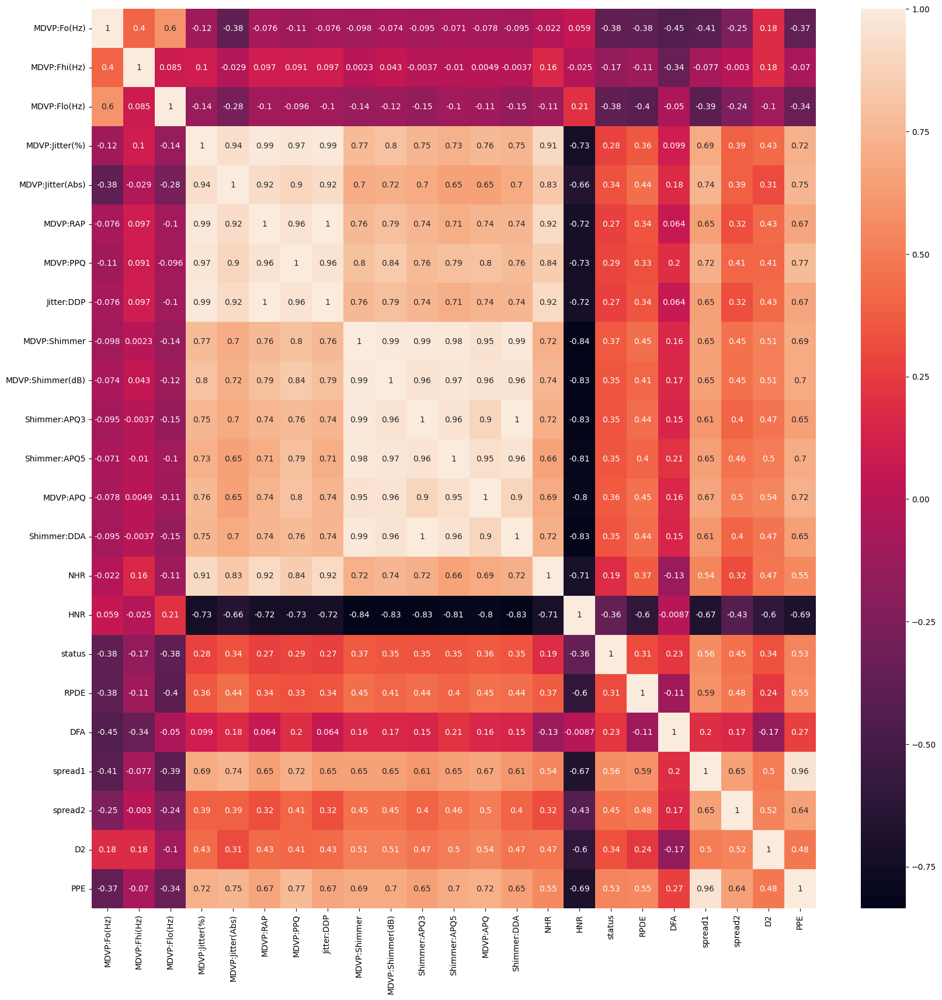

In [15]:
data.corr()
plt.figure(figsize=(20, 20))
p = sns.heatmap(data.corr(), annot=True)

# Data Transformation Techniques

In [16]:
# Using Z-score normalization to normalize the train data
means = np.mean(train_data, axis=0)
stds = np.std(train_data, axis=0)
normalized_df_train = (train_data - means)/stds

# Using Z-score normalization to normalize the test data
means = np.mean(test_data, axis=0)
stds = np.std(test_data, axis=0)
normalized_df_test = (test_data - means)/stds

print(normalized_df_train.head())
print(normalized_df_test.head())

   MDVP:Fo(Hz)  MDVP:Fhi(Hz)  MDVP:Flo(Hz)  MDVP:Jitter(%)  MDVP:Jitter(Abs)  \
0    -0.943670     -0.836715     -0.261193        0.966753          1.344148   
1    -1.159568     -0.879282     -0.427356       -0.084552          0.120388   
2    -0.566601      0.030685     -0.875693        0.381216          0.426328   
3     2.039725      0.766668      2.231680       -0.428334         -0.797431   
4     0.348130     -0.010036      0.580582       -0.279732         -0.491491   

   MDVP:RAP  MDVP:PPQ  Jitter:DDP  MDVP:Shimmer  MDVP:Shimmer(dB)  ...  \
0  0.668684  1.757644    0.667358      1.185680          1.146430  ...   
1 -0.127552  0.076597   -0.128863      0.859090          0.722703  ...   
2  0.461444  0.397349    0.461334      1.059148          1.063886  ...   
3 -0.269347 -0.421920   -0.268232     -0.336700         -0.278834  ...   
4 -0.214811 -0.197780   -0.216120      0.701779          0.458561  ...   

   MDVP:APQ  Shimmer:DDA       NHR       HNR      RPDE       DFA   spread1

# Visualization Techniques

# BoxPlot

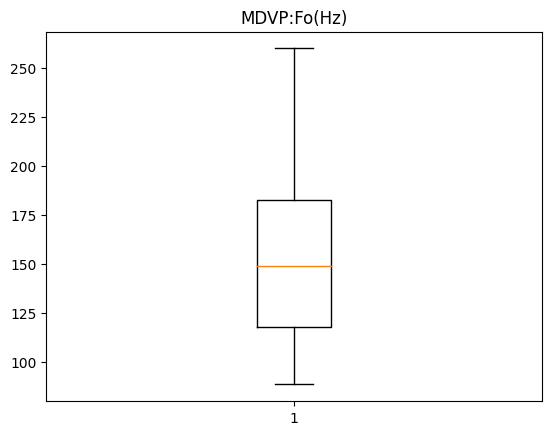

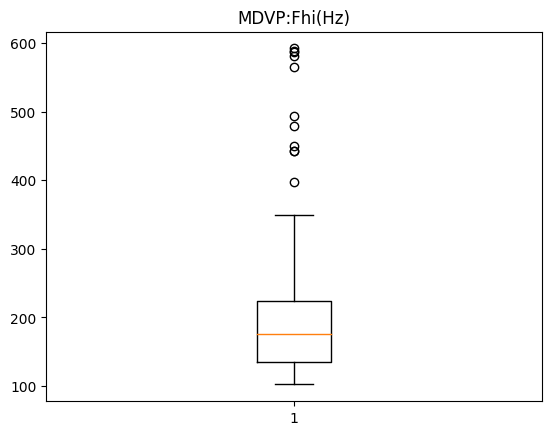

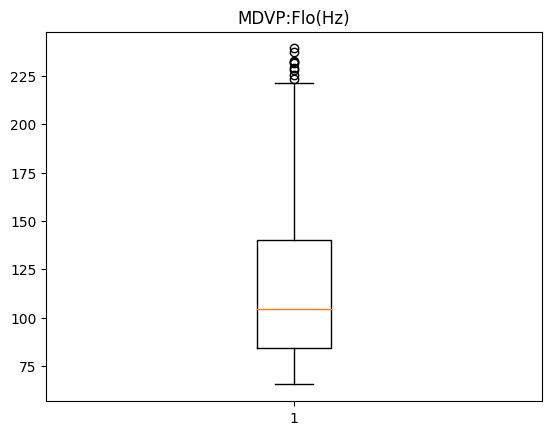

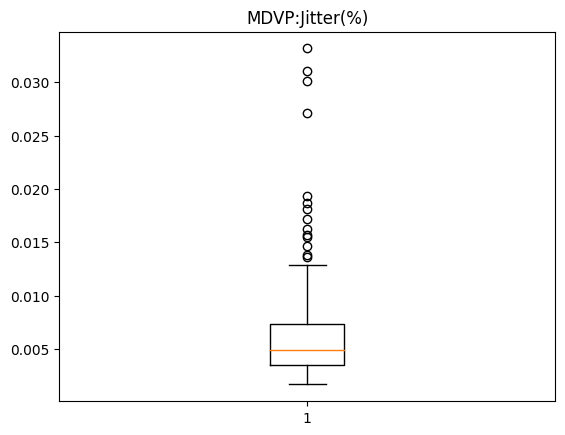

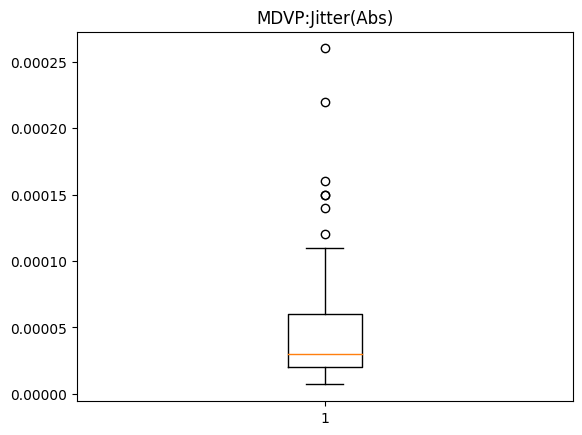

...

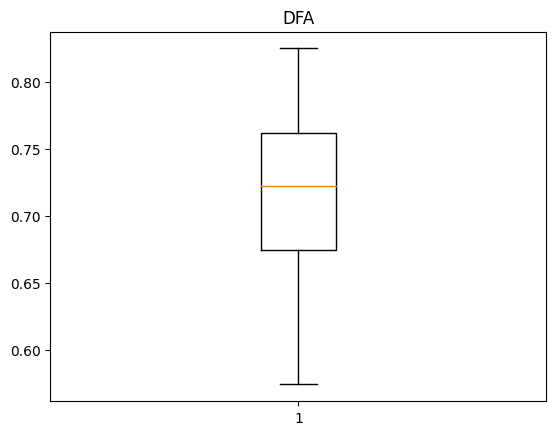

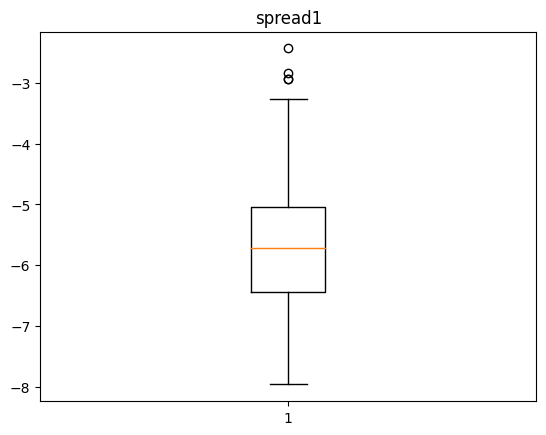

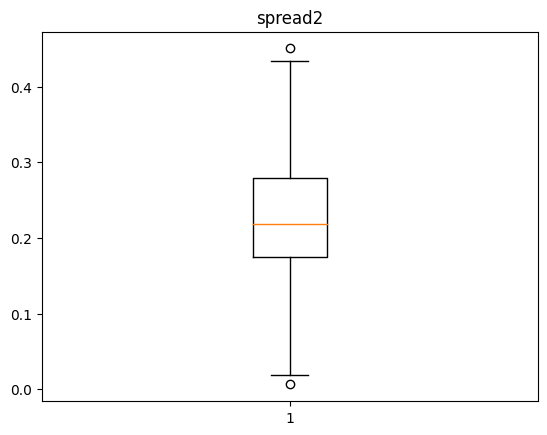

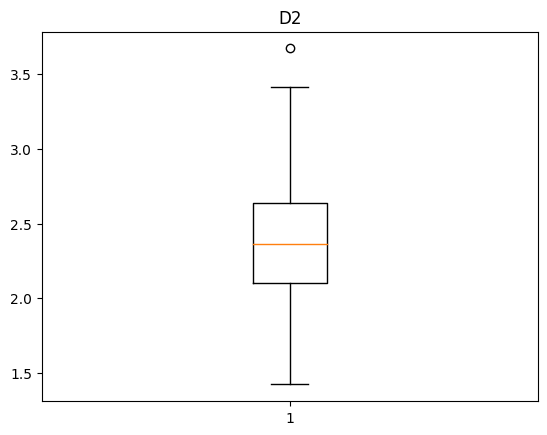

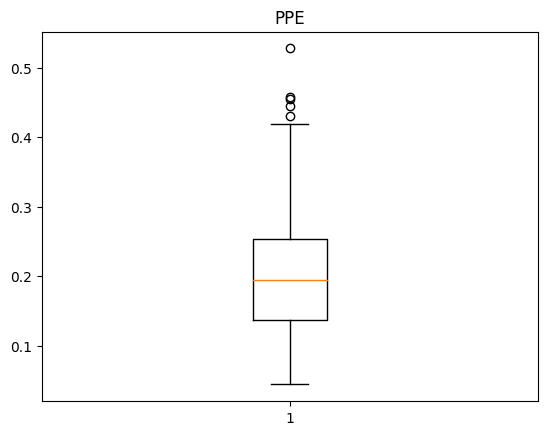

In [17]:
#Creating a BoxPlot

for col in data.columns:
    if col != "name" and col != "status":
        fig, ax = plt.subplots()
        ax.boxplot(data[col])
        ax.set_title(col)
        plt.show()

# Scatter Plot

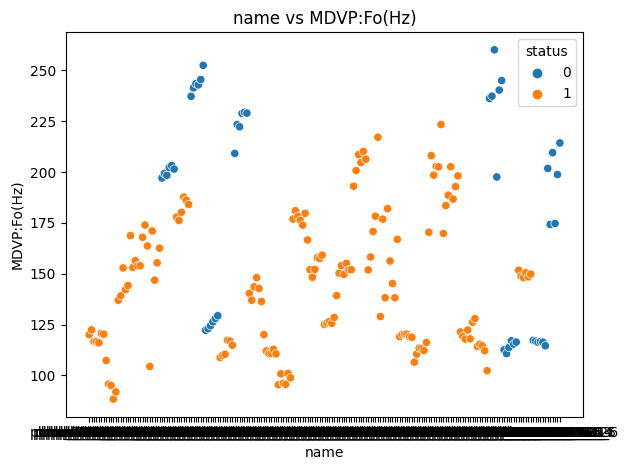

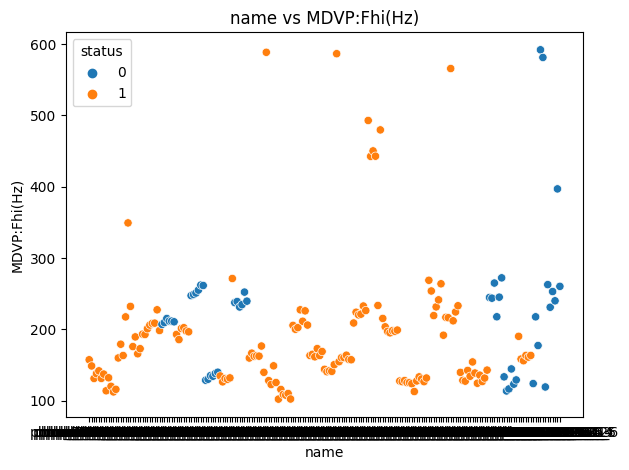

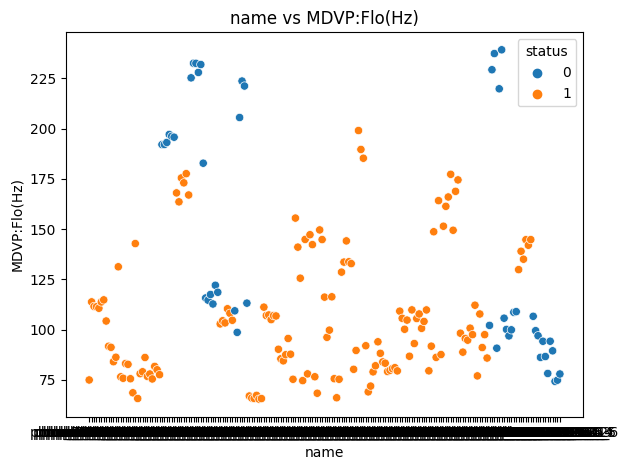

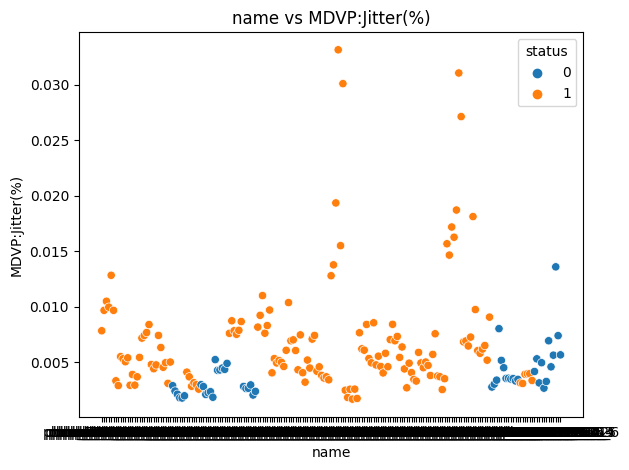

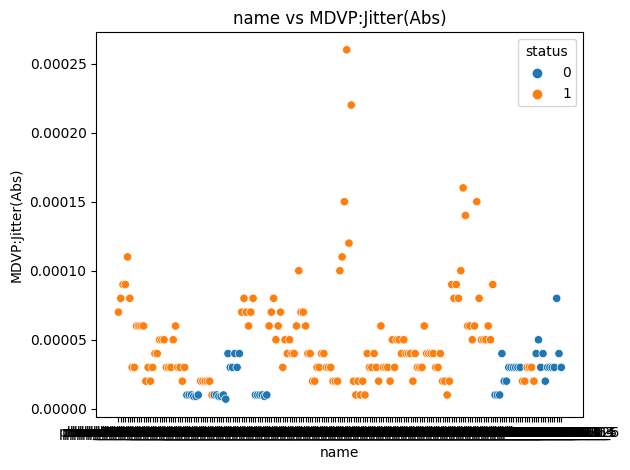

...

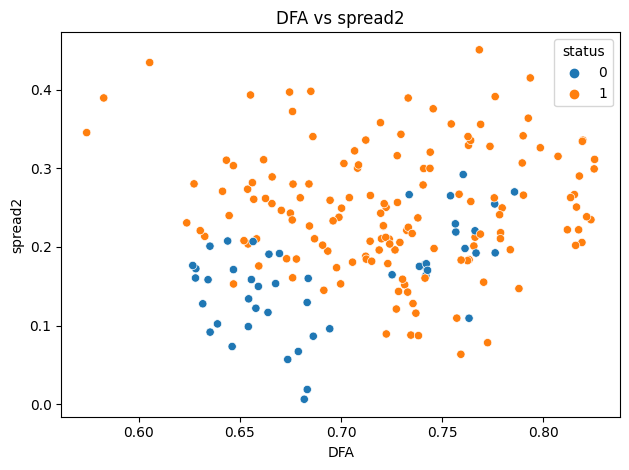

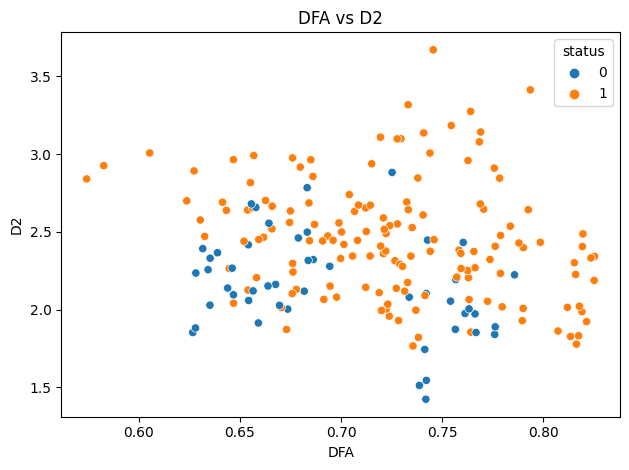

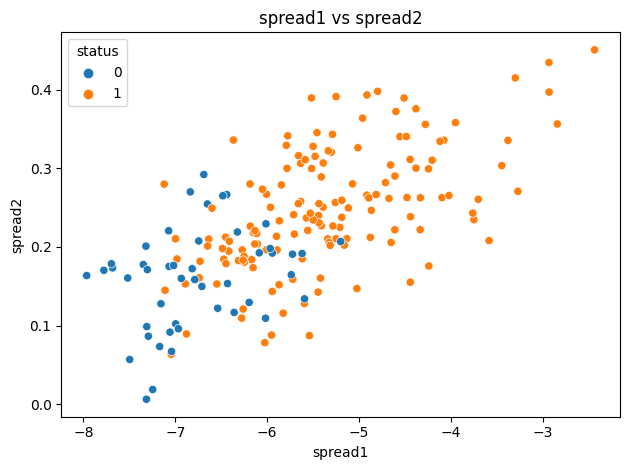

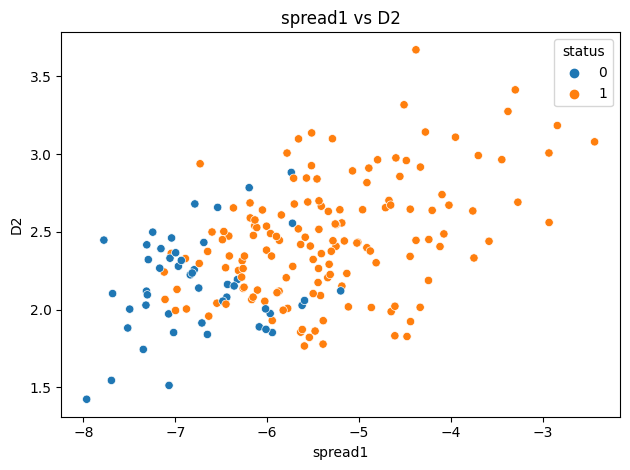

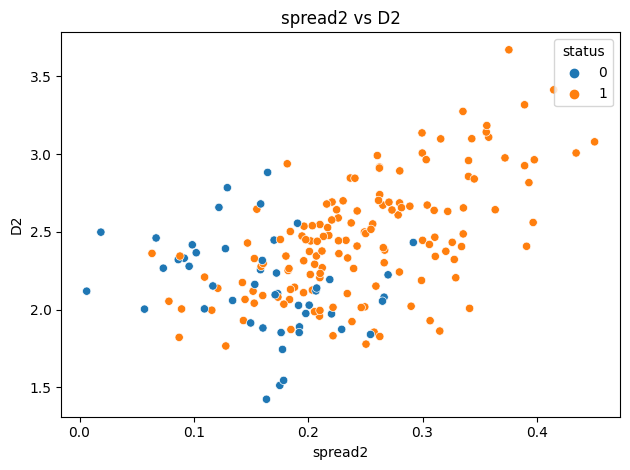

In [18]:
# Create all possible combinations of features
feature_combinations = []
for i, feature1 in enumerate(data.columns[:-1]):
    for j, feature2 in enumerate(data.columns[:-1]):
        if j > i:
            feature_combinations.append((feature1, feature2))

# Plot all scatter plots
for feature1, feature2 in feature_combinations:
    sns.scatterplot(data=data, x=feature1, y=feature2, hue="status")
    plt.title(f"{feature1} vs {feature2}")
    plt.tight_layout()
    plt.show()

# Pair Plot

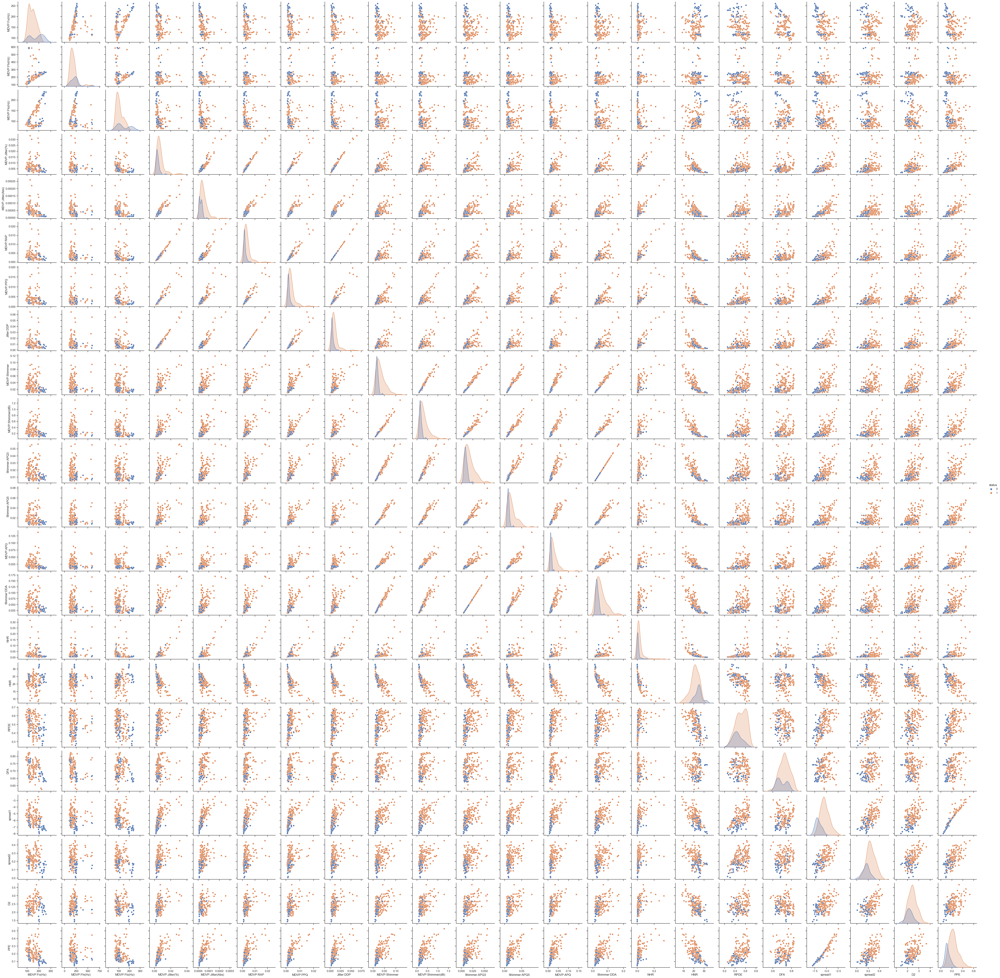

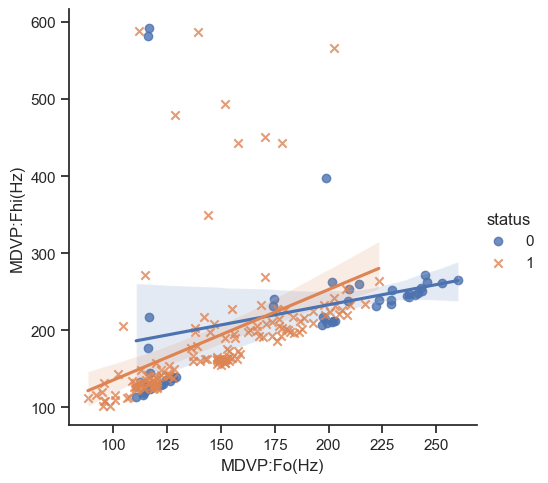

In [19]:
sns.set(style="ticks", color_codes=True)
sns.pairplot(data, hue="status")
plt.show()

sns.lmplot(x="MDVP:Fo(Hz)", y="MDVP:Fhi(Hz)", data=data, hue="status", markers=["o", "x"])
plt.show()

# Pie Chart

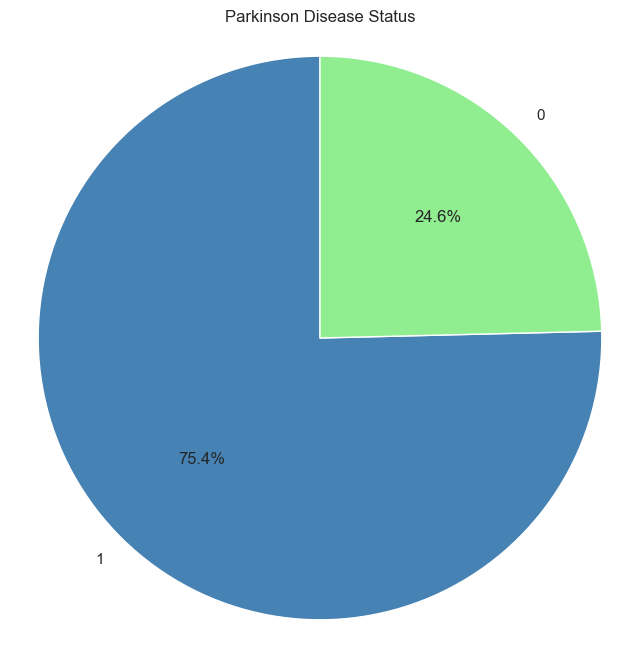

In [20]:
# Count the number of occurrences for each status
status_counts = data['status'].value_counts()

# Get the labels and sizes for the pie chart
labels = status_counts.index
sizes = status_counts.values

# Set the colors for the pie chart
colors = ['steelblue', 'lightgreen']

# Create the pie chart
plt.figure(figsize=(8, 8))
plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=90)

# Set aspect ratio to be equal so that pie is drawn as a circle
plt.axis('equal')

# Add a title
plt.title('Parkinson Disease Status')

# Display the pie chart
plt.show()


# Machine Learning Models

In [21]:
ml_names = ['lr', 'nb', 'dt', 'svm', 'knn']
lml_names = ['LR', 'NB', 'DT', 'SVM', 'KNN']

cml_names = ['blue', 'deeppink', 'crimson', 'aqua', 'gold']
cml_names.append('brown')


# 1. Logistic Regression

In [22]:
# Fit logistic regression model
model_lr = LogisticRegression(solver='lbfgs', max_iter=1000)
model_lr.fit(train_data, train_labels)

LogisticRegression(max_iter=1000)

# 2. Navie Bayes

In [23]:
# Fit Gaussian Naive Bayes model
model_nb = GaussianNB()
model_nb.fit(train_data, train_labels)

GaussianNB()

# 3. Support Vector Machines

In [24]:
# Fit Support Vector Machine Classifier (SVM) model
model_svm = SVC(kernel='linear', C=1, random_state=42, probability=True)
model_svm.fit(train_data, train_labels)

SVC(C=1, kernel='linear', probability=True, random_state=42)

# 4. Decision Tree

In [25]:
# Fit Decision Tree model
model_dt = DecisionTreeClassifier(max_depth=3, random_state=42)
model_dt.fit(train_data, train_labels)

DecisionTreeClassifier(max_depth=3, random_state=42)

# 5. K-Nearest Neighbors

In [26]:
# Fit K-Nearest Neighbors model
model_knn = KNeighborsClassifier(n_neighbors=10)
model_knn.fit(train_data, train_labels)

KNeighborsClassifier(n_neighbors=10)

# 6. Elastic Net Regression

In [27]:
# Create an instance of the Elastic Net model
model_en = ElasticNet(alpha=0.5, l1_ratio=0.5)

# Fit the model to the training data
model_en.fit(train_data, train_labels)


ElasticNet(alpha=0.5)

# Ensemble Learning Models

In [28]:
em_names = ['rf', 'bagging', 'xgb', 'ada', 'cb', 'gb', 'stacking', "vh", "vs", "blend"]
lem_names = ['RF', 'Bagging','XGBoost', 'Adaboost', 'Catboost', 'GradientBoost', 'Stacking', "Voting Hard", "Voting Soft", "Blending"]

cem_names = ['darkgreen', 'maroon', 'mediumblue', 'goldenrod', 'fuchsia', 'saddlebrown', 'teal', "cyan", "red", "yellow"]

# Create a list of the models to be ensembled
em_models = [('lr', model_lr), ('nb', model_nb), ('dt', model_dt), ('svm', model_svm), ('knn', model_knn)]

# 1. Random Forest

In [29]:
# Fit Random forest model
model_rf = RandomForestClassifier(n_estimators=100, max_depth=3, random_state=42)
model_rf.fit(train_data, train_labels)

RandomForestClassifier(max_depth=3, random_state=42)

# 2. Bagging

In [30]:
# Aggregate the predictions made by each BaggingClassifier
y_preds = []
for name, model in em_models:
    # Create a BaggingClassifier object for the current model
    bagging_model = BaggingClassifier(model, n_estimators=10, max_samples=0.8, random_state=42)
    
    # Train the BaggingClassifier on the training set
    bagging_model.fit(train_data, train_labels)

    # Make predictions on the testing set
    y_pred = bagging_model.predict_proba(test_data)[:, 1]
    
    # Append the predicted probabilities to the list of predictions
    y_preds.append(y_pred)

# Aggregate the predictions using weighted voting
weights = [0.2, 0.2, 0.2, 0.2, 0.2]
model_bagging = np.average(y_preds, axis=0, weights=weights)

# 3. XGBoost

In [31]:
# Fit XGboost model
model_xgb = xgb.XGBClassifier()
model_xgb.fit(train_data, train_labels)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

# 4. AdaBoost

In [32]:
# Create an AdaBoost classifier with 50 estimators
model_ada = AdaBoostClassifier(n_estimators=50, random_state=42)

# Fit the AdaBoost classifier to the training data
model_ada.fit(train_data,train_labels)

AdaBoostClassifier(random_state=42)

# 5. CatBoost

In [33]:
# Create an instance of the CatBoostClassifier
model_cb = CatBoostClassifier(iterations=100, learning_rate=0.1, depth=6)

# Fit the model on the training data
model_cb.fit(train_data, train_labels)

0:	learn: 0.5791100	total: 138ms	remaining: 13.6s
1:	learn: 0.4843887	total: 142ms	remaining: 6.97s
2:	learn: 0.3983736	total: 147ms	remaining: 4.76s
3:	learn: 0.3545774	total: 153ms	remaining: 3.68s
4:	learn: 0.3166596	total: 159ms	remaining: 3.02s
5:	learn: 0.2784543	total: 164ms	remaining: 2.58s
6:	learn: 0.2494991	total: 169ms	remaining: 2.24s
7:	learn: 0.2223059	total: 173ms	remaining: 1.99s
8:	learn: 0.2008280	total: 177ms	remaining: 1.79s
9:	learn: 0.1776477	total: 182ms	remaining: 1.64s
10:	learn: 0.1599327	total: 187ms	remaining: 1.51s
11:	learn: 0.1445901	total: 191ms	remaining: 1.4s
12:	learn: 0.1338952	total: 196ms	remaining: 1.31s
13:	learn: 0.1243230	total: 204ms	remaining: 1.25s
14:	learn: 0.1156905	total: 209ms	remaining: 1.19s
15:	learn: 0.1044267	total: 214ms	remaining: 1.13s
16:	learn: 0.0962275	total: 219ms	remaining: 1.07s
17:	learn: 0.0893489	total: 223ms	remaining: 1.02s
18:	learn: 0.0830555	total: 231ms	remaining: 983ms
19:	learn: 0.0775696	total: 237ms	remainin

# 6. Gradient Boosting

In [34]:
# Create a Gradient Boosting Classifier object
model_gb = GradientBoostingClassifier(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)

# Train the Gradient Boosting Classifier on the training set
model_gb.fit(train_data, train_labels)

GradientBoostingClassifier(random_state=42)

# 7. Stacking

In [35]:
model_stacking = StackingClassifier(estimators=em_models, final_estimator=LogisticRegression())

# Fit the stacking model on the training data
model_stacking.fit(train_data, train_labels)

StackingClassifier(estimators=[('lr', LogisticRegression(max_iter=1000)),
                               ('nb', GaussianNB()),
                               ('dt',
                                DecisionTreeClassifier(max_depth=3,
                                                       random_state=42)),
                               ('svm',
                                SVC(C=1, kernel='linear', probability=True,
                                    random_state=42)),
                               ('knn', KNeighborsClassifier(n_neighbors=10))],
                   final_estimator=LogisticRegression())


# 8. Voting [Hard]

In [36]:
# Define the voting classifier with hard voting
model_vh = VotingClassifier(estimators=em_models, voting='hard')

# Fit the models on the training data
model_vh.fit(train_data, train_labels)

VotingClassifier(estimators=[('lr', LogisticRegression(max_iter=1000)),
                             ('nb', GaussianNB()),
                             ('dt',
                              DecisionTreeClassifier(max_depth=3,
                                                     random_state=42)),
                             ('svm',
                              SVC(C=1, kernel='linear', probability=True,
                                  random_state=42)),
                             ('knn', KNeighborsClassifier(n_neighbors=10))])

# 9. Voting [Soft]

In [37]:
# Define the voting classifier with soft voting
model_vs = VotingClassifier(estimators=em_models, voting='soft')

# Fit the models on the training data
model_vs.fit(train_data, train_labels)

VotingClassifier(estimators=[('lr', LogisticRegression(max_iter=1000)),
                             ('nb', GaussianNB()),
                             ('dt',
                              DecisionTreeClassifier(max_depth=3,
                                                     random_state=42)),
                             ('svm',
                              SVC(C=1, kernel='linear', probability=True,
                                  random_state=42)),
                             ('knn', KNeighborsClassifier(n_neighbors=10))],
                 voting='soft')

# 10. Blending

In [38]:
# Splitting the train data into train and val set
train_set, val_set, train_set_labels, val_set_labels = train_test_split(train_data, train_labels, test_size=0.2, random_state=0)

In [39]:
base_predictions = []
meta_predictions = []

for name, model in em_models:
    model.fit(train_set, train_set_labels)
    base_prediction = model.predict(val_set)
    meta_prediction = model.predict(test_data)
    
    base_prediction = base_prediction.reshape(len(base_prediction), 1)
    meta_prediction = meta_prediction.reshape(len(meta_prediction), 1)
    
    base_predictions.append(base_prediction)
    meta_predictions.append(meta_prediction)

base_predictions = np.hstack(base_predictions)
meta_predictions = np.hstack(meta_predictions)

model_blend = LogisticRegression()
model_blend.fit(base_predictions, val_set_labels)

LogisticRegression()

# Evaluation metrics with ROC-AUC plot [individual]

Confusion matrix of the model LR : 
[[ 4  3]
 [ 5 27]]
True Negative of the model LR -> 4
False Positive of the model LR -> 3
False Negative of the model LR -> 5
True Positive of the model LR -> 27
Accuracy of the model LR -> 0.7948717948717948
Misclassification rate of the model LR -> 0.20512820512820518
Precision of the model LR -> 0.9
Recall of the model LR -> 0.84375
F1 Measure of the model LR -> 0.870967741935484
AUC of the model LR -> 0.84375




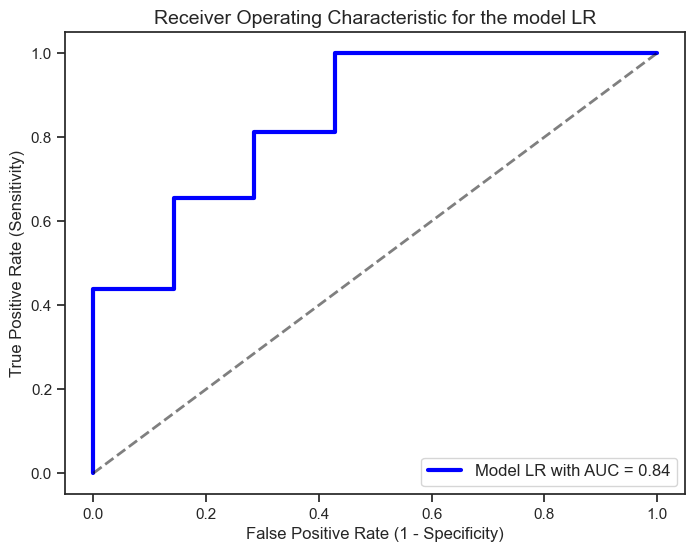

Confusion matrix of the model NB : 
[[ 6  1]
 [10 22]]
True Negative of the model NB -> 6
False Positive of the model NB -> 1
False Negative of the model NB -> 10
True Positive of the model NB -> 22
Accuracy of the model NB -> 0.717948717948718
Misclassification rate of the model NB -> 0.28205128205128205
Precision of the model NB -> 0.9565217391304348
Recall of the model NB -> 0.6875
F1 Measure of the model NB -> 0.8
AUC of the model NB -> 0.8080357142857143




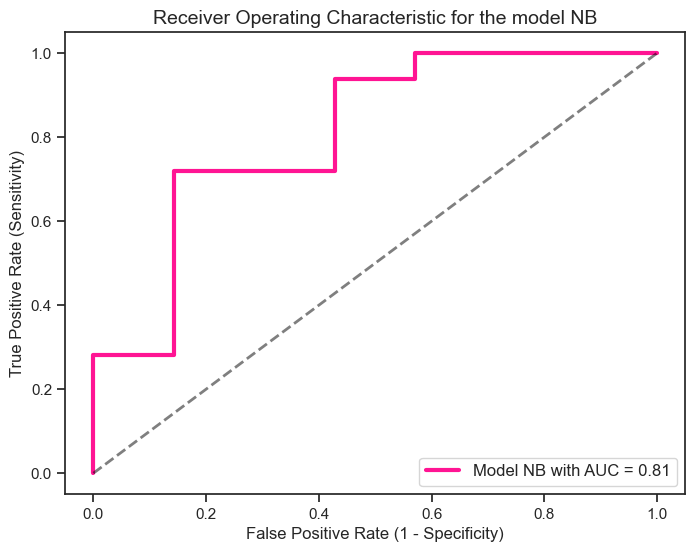

Confusion matrix of the model DT : 
[[ 4  3]
 [ 5 27]]
True Negative of the model DT -> 4
False Positive of the model DT -> 3
False Negative of the model DT -> 5
True Positive of the model DT -> 27
Accuracy of the model DT -> 0.7948717948717948
Misclassification rate of the model DT -> 0.20512820512820518
Precision of the model DT -> 0.9
Recall of the model DT -> 0.84375
F1 Measure of the model DT -> 0.870967741935484
AUC of the model DT -> 0.7678571428571428




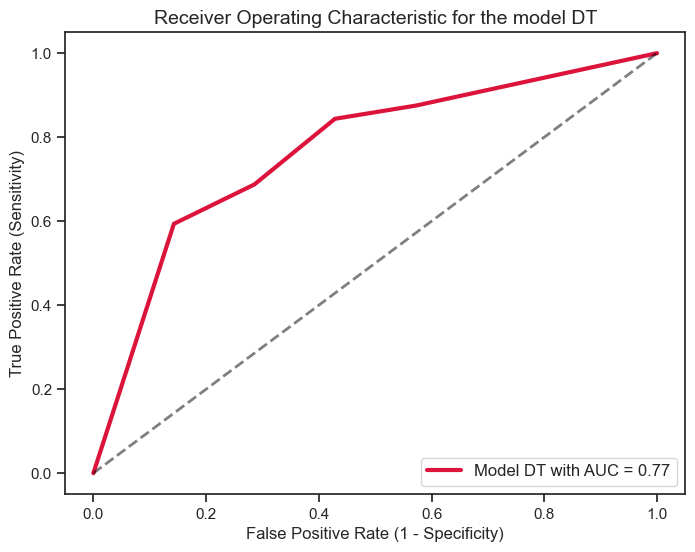

Confusion matrix of the model SVM : 
[[ 4  3]
 [ 3 29]]
True Negative of the model SVM -> 4
False Positive of the model SVM -> 3
False Negative of the model SVM -> 3
True Positive of the model SVM -> 29
Accuracy of the model SVM -> 0.8461538461538461
Misclassification rate of the model SVM -> 0.15384615384615385
Precision of the model SVM -> 0.90625
Recall of the model SVM -> 0.90625
F1 Measure of the model SVM -> 0.90625
AUC of the model SVM -> 0.8616071428571428




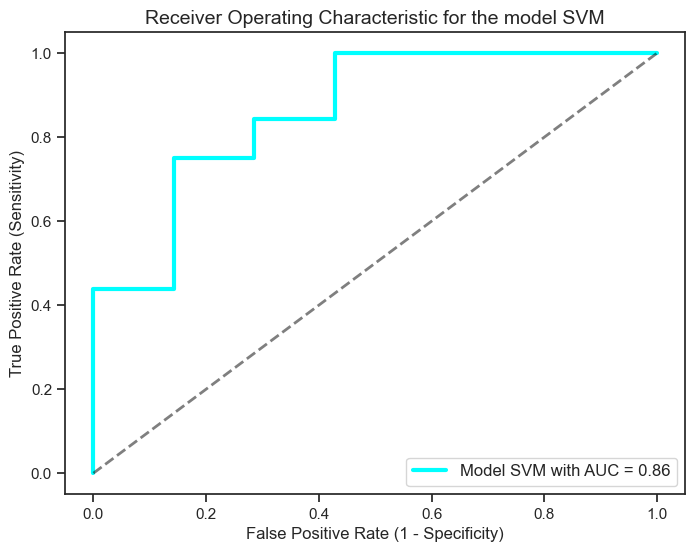

Confusion matrix of the model KNN : 
[[ 4  3]
 [11 21]]
True Negative of the model KNN -> 4
False Positive of the model KNN -> 3
False Negative of the model KNN -> 11
True Positive of the model KNN -> 21
Accuracy of the model KNN -> 0.6410256410256411
Misclassification rate of the model KNN -> 0.3589743589743589
Precision of the model KNN -> 0.875
Recall of the model KNN -> 0.65625
F1 Measure of the model KNN -> 0.75
AUC of the model KNN -> 0.7299107142857143




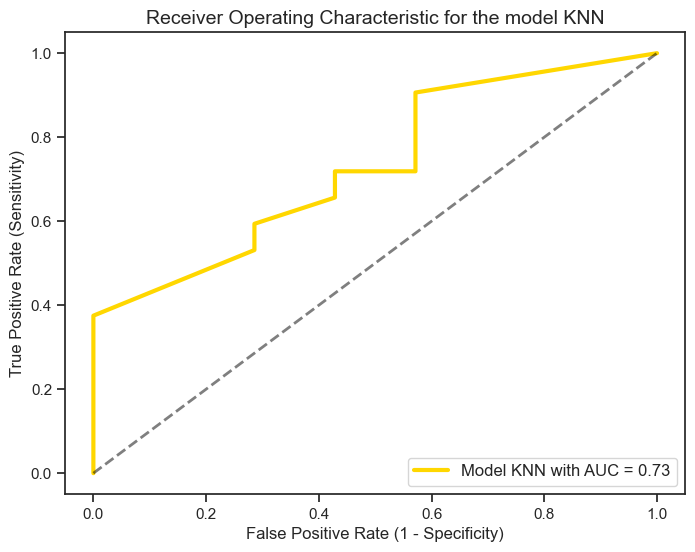

Confusion matrix of the model RF : 
[[ 5  2]
 [ 2 30]]
True Negative of the model RF -> 5
False Positive of the model RF -> 2
False Negative of the model RF -> 2
True Positive of the model RF -> 30
Accuracy of the model RF -> 0.8974358974358975
Misclassification rate of the model RF -> 0.10256410256410253
Precision of the model RF -> 0.9375
Recall of the model RF -> 0.9375
F1 Measure of the model RF -> 0.9375
AUC of the model RF -> 0.9375




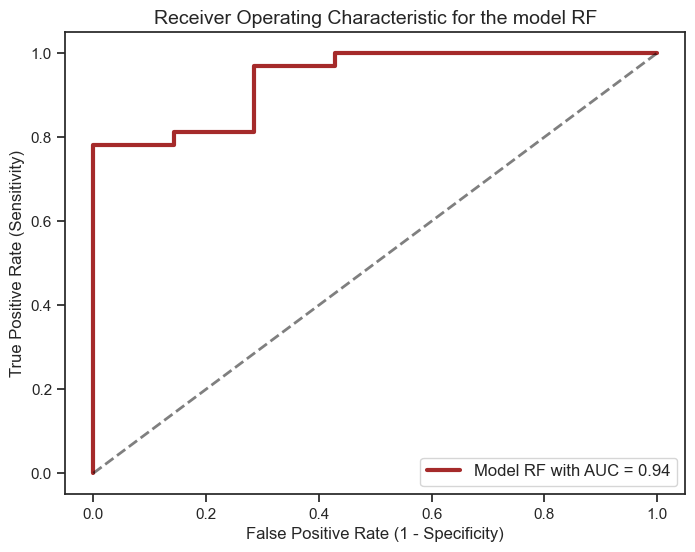

Confusion matrix of the model Bagging : 
[[ 4  3]
 [ 3 29]]
True Negative of the model Bagging -> 4
False Positive of the model Bagging -> 3
False Negative of the model Bagging -> 3
True Positive of the model Bagging -> 29
Accuracy of the model Bagging -> 0.8461538461538461
Misclassification rate of the model Bagging -> 0.15384615384615385
Precision of the model Bagging -> 0.90625
Recall of the model Bagging -> 0.90625
F1 Measure of the model Bagging -> 0.90625
AUC of the model Bagging -> 0.7388392857142856




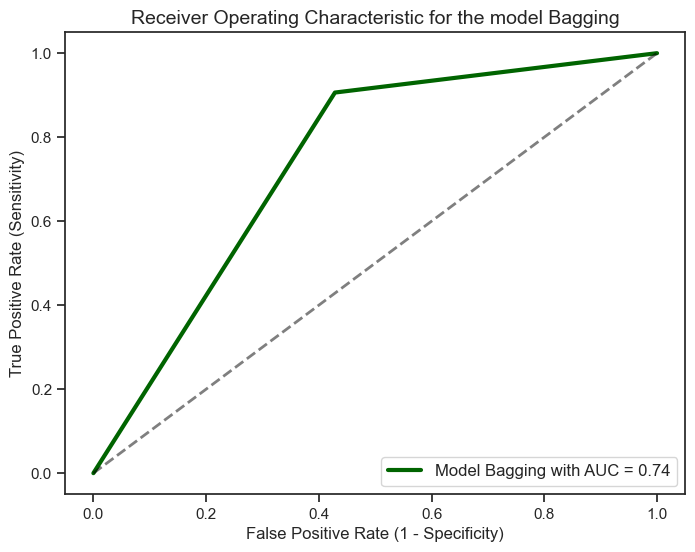

Confusion matrix of the model XGBoost : 
[[ 5  2]
 [ 2 30]]
True Negative of the model XGBoost -> 5
False Positive of the model XGBoost -> 2
False Negative of the model XGBoost -> 2
True Positive of the model XGBoost -> 30
Accuracy of the model XGBoost -> 0.8974358974358975
Misclassification rate of the model XGBoost -> 0.10256410256410253
Precision of the model XGBoost -> 0.9375
Recall of the model XGBoost -> 0.9375
F1 Measure of the model XGBoost -> 0.9375
AUC of the model XGBoost -> 0.9598214285714286




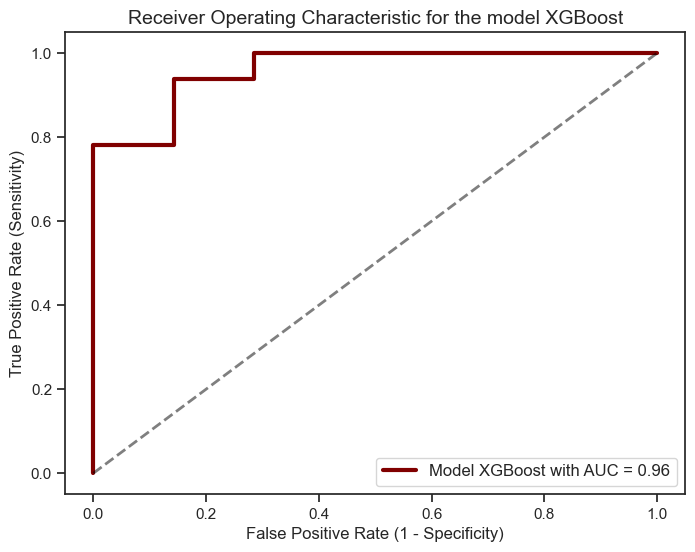

Confusion matrix of the model Adaboost : 
[[ 4  3]
 [ 2 30]]
True Negative of the model Adaboost -> 4
False Positive of the model Adaboost -> 3
False Negative of the model Adaboost -> 2
True Positive of the model Adaboost -> 30
Accuracy of the model Adaboost -> 0.8717948717948718
Misclassification rate of the model Adaboost -> 0.1282051282051282
Precision of the model Adaboost -> 0.9090909090909091
Recall of the model Adaboost -> 0.9375
F1 Measure of the model Adaboost -> 0.923076923076923
AUC of the model Adaboost -> 0.8973214285714286




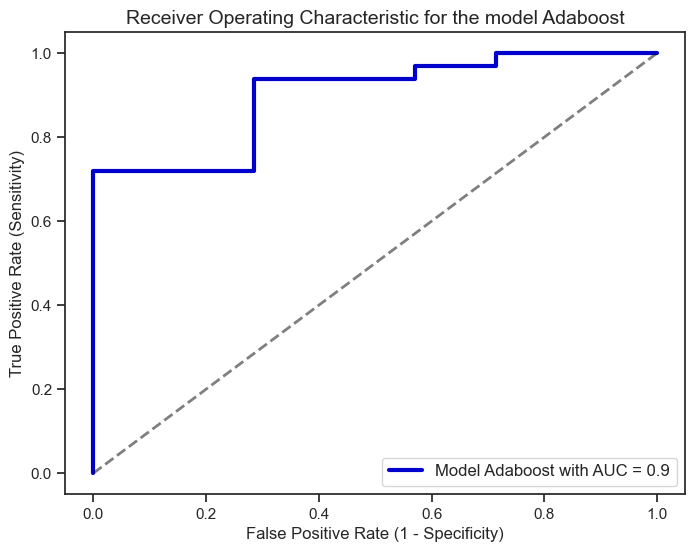

Confusion matrix of the model Catboost : 
[[ 5  2]
 [ 1 31]]
True Negative of the model Catboost -> 5
False Positive of the model Catboost -> 2
False Negative of the model Catboost -> 1
True Positive of the model Catboost -> 31
Accuracy of the model Catboost -> 0.9230769230769231
Misclassification rate of the model Catboost -> 0.07692307692307687
Precision of the model Catboost -> 0.9393939393939394
Recall of the model Catboost -> 0.96875
F1 Measure of the model Catboost -> 0.9538461538461539
AUC of the model Catboost -> 0.9598214285714286




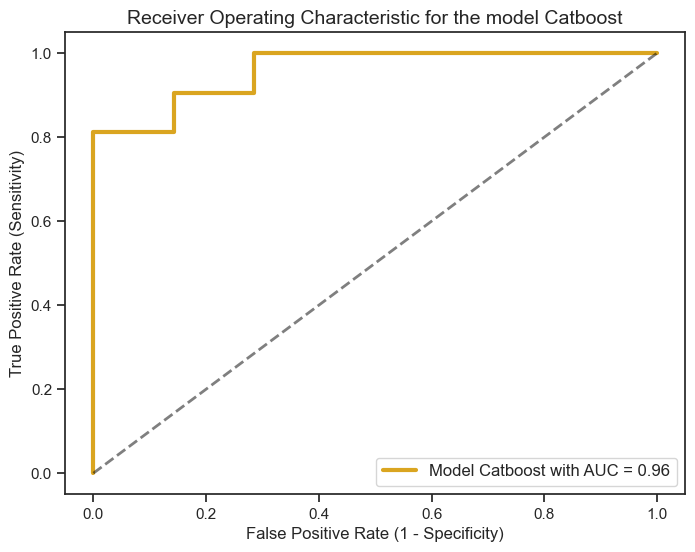

Confusion matrix of the model GradientBoost : 
[[ 5  2]
 [ 2 30]]
True Negative of the model GradientBoost -> 5
False Positive of the model GradientBoost -> 2
False Negative of the model GradientBoost -> 2
True Positive of the model GradientBoost -> 30
Accuracy of the model GradientBoost -> 0.8974358974358975
Misclassification rate of the model GradientBoost -> 0.10256410256410253
Precision of the model GradientBoost -> 0.9375
Recall of the model GradientBoost -> 0.9375
F1 Measure of the model GradientBoost -> 0.9375
AUC of the model GradientBoost -> 0.9464285714285714




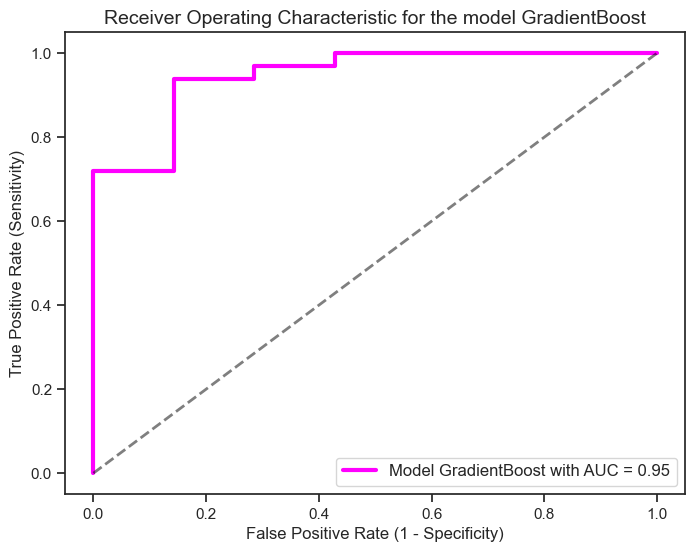

Confusion matrix of the model Stacking : 
[[ 5  2]
 [ 2 30]]
True Negative of the model Stacking -> 5
False Positive of the model Stacking -> 2
False Negative of the model Stacking -> 2
True Positive of the model Stacking -> 30
Accuracy of the model Stacking -> 0.8974358974358975
Misclassification rate of the model Stacking -> 0.10256410256410253
Precision of the model Stacking -> 0.9375
Recall of the model Stacking -> 0.9375
F1 Measure of the model Stacking -> 0.9375
AUC of the model Stacking -> 0.8705357142857143




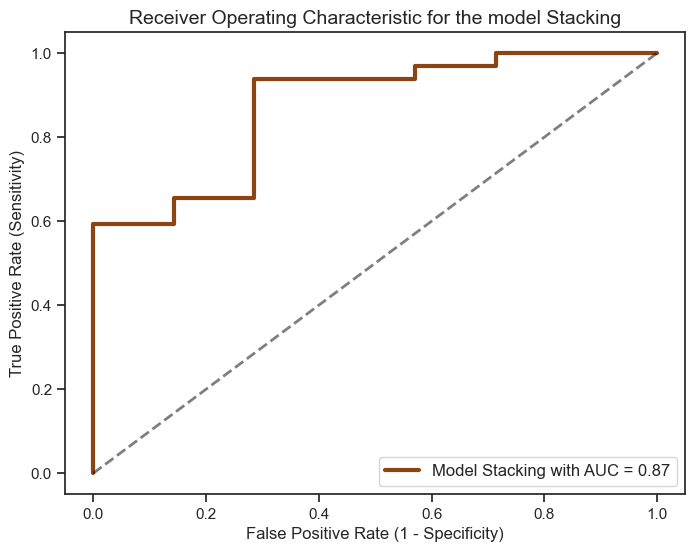

Confusion matrix of the model Voting Hard : 
[[ 4  3]
 [ 2 30]]
True Negative of the model Voting Hard -> 4
False Positive of the model Voting Hard -> 3
False Negative of the model Voting Hard -> 2
True Positive of the model Voting Hard -> 30
Accuracy of the model Voting Hard -> 0.8717948717948718
Misclassification rate of the model Voting Hard -> 0.1282051282051282
Precision of the model Voting Hard -> 0.9090909090909091
Recall of the model Voting Hard -> 0.9375
F1 Measure of the model Voting Hard -> 0.923076923076923
AUC of the model Voting Hard -> 0.7544642857142856




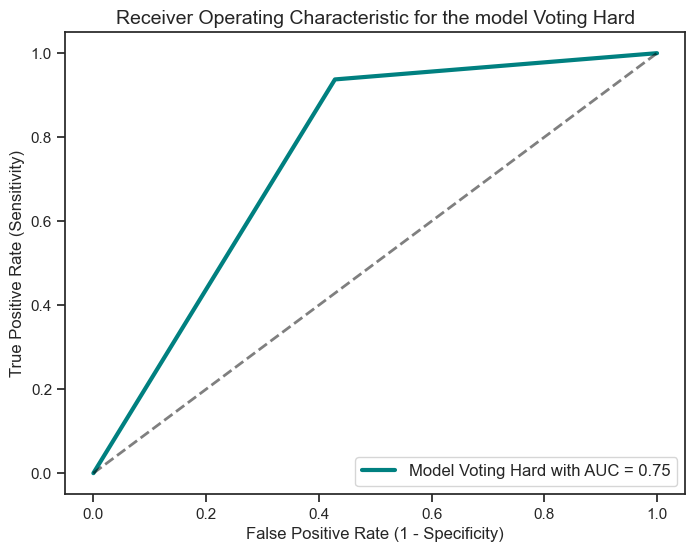

Confusion matrix of the model Voting Soft : 
[[ 5  2]
 [ 3 29]]
True Negative of the model Voting Soft -> 5
False Positive of the model Voting Soft -> 2
False Negative of the model Voting Soft -> 3
True Positive of the model Voting Soft -> 29
Accuracy of the model Voting Soft -> 0.8717948717948718
Misclassification rate of the model Voting Soft -> 0.1282051282051282
Precision of the model Voting Soft -> 0.9354838709677419
Recall of the model Voting Soft -> 0.90625
F1 Measure of the model Voting Soft -> 0.9206349206349206
AUC of the model Voting Soft -> 0.8794642857142857




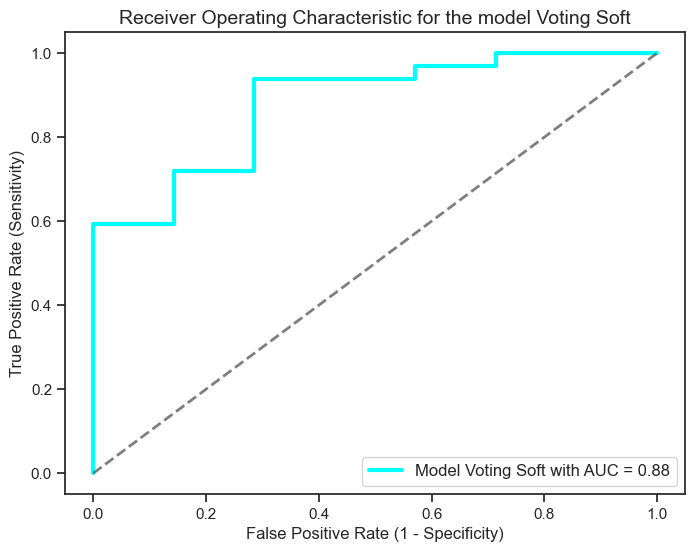

Confusion matrix of the model Blending : 
[[ 5  2]
 [ 3 29]]
True Negative of the model Blending -> 5
False Positive of the model Blending -> 2
False Negative of the model Blending -> 3
True Positive of the model Blending -> 29
Accuracy of the model Blending -> 0.8717948717948718
Misclassification rate of the model Blending -> 0.1282051282051282
Precision of the model Blending -> 0.9354838709677419
Recall of the model Blending -> 0.90625
F1 Measure of the model Blending -> 0.9206349206349206
AUC of the model Blending -> 0.8035714285714286




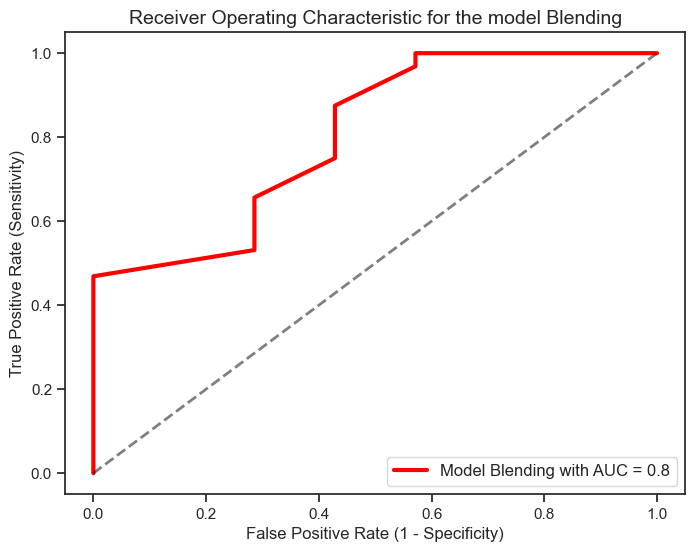

In [40]:
model_names = ml_names + em_names 
legend_names = lml_names + lem_names 
colors_names = cml_names + cem_names 

def eval_function_with_roc_plot():
    ml_curves = []
    em_curves = []
    
    
    for model in model_names:
        name = legend_names[model_names.index(model)]
        
        if name == "SVM":
            model_prediction = eval(f"model_{model}.predict(test_data)")
            model_proba = eval(f"model_{model}.decision_function(test_data)")
        elif name == "Bagging":
            model_proba = np.round(eval(f"model_{model}"))
            model_prediction = model_proba
        elif name == "Voting Hard":
            model_prediction = eval(f"model_{model}.predict(test_data)")
            model_proba = model_prediction
        elif name == "Blending":
            model_predictions = eval(f"model_{model}.predict(meta_predictions)")
            model_proba = eval(f"model_{model}.predict_proba(meta_predictions)[:, 1] ")
        elif name == "ANN":
            model_proba = eval(f"model_{model}.predict(test_features.reshape(test_features.shape[0], -1))")
            model_proba = np.where(model_proba> 0.5, 1, 0)
            model_prediction = model_proba
        elif name == "SimpleRNN" or name == "LSTM" or name == "GRU":
            model_proba = eval(f"model_{model}.predict(test_features)")
            model_proba = np.where(model_proba> 0.5, 1, 0)
            model_prediction = model_proba
        else:
            model_prediction = eval(f"model_{model}.predict(test_data)")
            model_proba = eval(f"model_{model}.predict_proba(test_data)[:, 1] ")
        
        model_cm = confusion_matrix(test_labels, model_prediction)    
        tn, fp, fn, tp = model_cm.ravel()
        
        model_accuracy = accuracy_score(test_labels, model_prediction)
        model_misclassification = 1 - accuracy_score(test_labels, model_prediction)
        model_precision = precision_score(test_labels, model_prediction)
        model_recall = recall_score(test_labels, model_prediction)
        model_f1 = f1_score(test_labels, model_prediction)
        
        model_fpr, model_tpr, model_thresholds = roc_curve(test_labels, model_proba)
        model_auc = auc(model_fpr, model_tpr)

        print(f"Confusion matrix of the model {name} : \n{model_cm}")
        print(f'True Negative of the model {name} -> {tn}')
        print(f'False Positive of the model {name} -> {fp}')
        print(f'False Negative of the model {name} -> {fn}')
        print(f'True Positive of the model {name} -> {tp}')
        print(f"Accuracy of the model {name} -> {model_accuracy}")
        print(f"Misclassification rate of the model {name} -> {model_misclassification}")
        print(f"Precision of the model {name} -> {model_precision}")
        print(f"Recall of the model {name} -> {model_recall}")
        print(f"F1 Measure of the model {name} -> {model_f1}")
        print(f"AUC of the model {name} -> {model_auc}")
        print("\n")

        plt.figure(figsize=(8, 6))
        roc = "plt.plot(model_fpr, model_tpr, color=colors_names[model_names.index(model)], lw=3, label=f'Model {name} with AUC = {round(model_auc, 2)}' % model_auc)"
        eval(f"{roc}")
        plt.plot([0, 1], [0, 1], color='black', linestyle='--', lw=2, alpha=0.5)

        # Customize legend position
        plt.legend(loc = 'lower right', fontsize=12)

        # Add labels and title
        plt.xlabel('False Positive Rate (1 - Specificity)')
        plt.ylabel('True Positive Rate (Sensitivity)')
        plt.title(f'Receiver Operating Characteristic for the model {name}', fontsize=14)
        plt.show()
        
        if name in lml_names:
            ml_curves.append([model_fpr, model_tpr, colors_names[model_names.index(model)], name, model_auc])
        elif name in lem_names:
            em_curves.append([model_fpr, model_tpr, colors_names[model_names.index(model)], name, model_auc])
       
            
    return ml_curves, em_curves

    
ml_c, em_c = eval_function_with_roc_plot()
print("\n")